In [37]:
import pandas as pd
import numpy as np
import pickle
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

import warnings
warnings.filterwarnings('ignore')

import spacy
import nltk
from nltk.corpus import opinion_lexicon, stopwords
from scipy.sparse import coo_matrix
from nltk.corpus import nps_chat
from pattern.en import suggest
import nltk.classify.util
from nltk.tokenize import sent_tokenize, word_tokenize, RegexpTokenizer
from nltk.classify import NaiveBayesClassifier
from nltk.corpus import stopwords, names
import spacy
import contextualSpellCheck
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import re
from wordcloud import WordCloud
from tqdm import tqdm
from progress.bar import Bar
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import NMF
from sklearn.metrics.pairwise import cosine_similarity
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

import seaborn as sns
import matplotlib.pyplot as plt


In [38]:
df_subset =  pickle.load(open("df.p", "rb"))

In [39]:
display('df_subset.shape: {}'.format(df_subset.shape))

'df_subset.shape: (222293, 41)'

<AxesSubplot:xlabel='review_stars', ylabel='Count'>

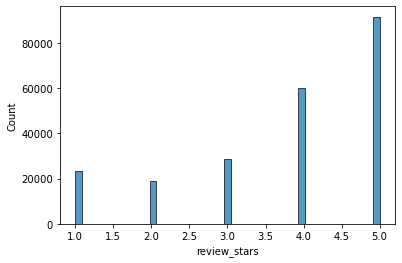

In [449]:
sns.histplot(df_subset['review_stars'], bins=45)

In [450]:
df_subset['length'] = df_subset['review_text'].apply(len)

<AxesSubplot:xlabel='length', ylabel='Count'>

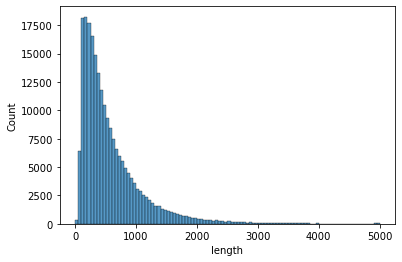

In [451]:
sns.histplot(df_subset['length'], bins=100)

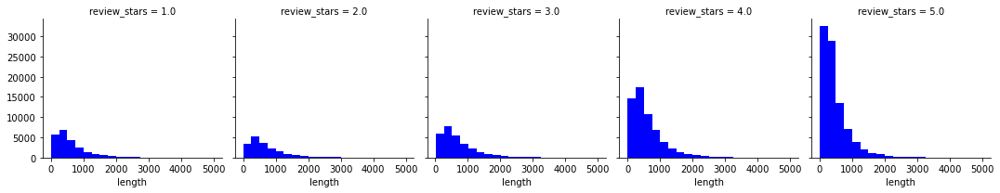

In [452]:
g = sns.FacetGrid(df_subset, col='review_stars', col_wrap=5)
g.map(plt.hist, 'length', bins=20, color='b')

In [12]:
def plot_word_cloud(data):
    '''
    Function to plot word cloud from a pandas series
    Input: data: pandas.core.series.Series object
    Output: Wordcloud of most recurrent words in data
        for plots to be in ipython notebook include following line before calling this function
        %matplotlib inline 
    '''
    # take relative word frequencies into account, lower max_font_size
    wordcloud = WordCloud(background_color='white', max_font_size=40, relative_scaling=.9).generate(str(data))

    plt.figure()
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.show()

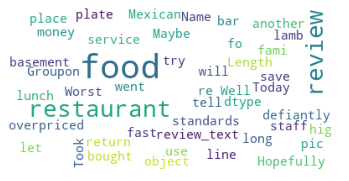

In [13]:
plot_word_cloud(df_subset["review_text"].loc[df_subset.review_stars == 1, ])

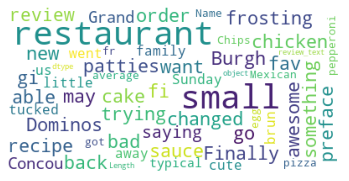

In [14]:
plot_word_cloud(df_subset["review_text"].loc[df_subset.review_stars == 3, ])

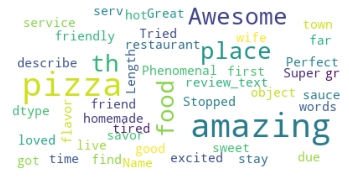

In [15]:
plot_word_cloud(df_subset["review_text"].loc[df_subset.review_stars == 5, ])

# Topic Modeling on original dataset

In [40]:
nlp = spacy.load('en_core_web_sm')
nlp.max_length = 1500000

In [41]:
# stop words
stopwords = set(stopwords.words('english'))
stopwords |= set(nps_chat.words())
stopwords |= set(opinion_lexicon.negative())
stopwords |= set(opinion_lexicon.positive())

In [42]:
#nlp.Defaults.stop_words |= {'-pron-'}
def preprocess(review_column):
    alphanumeric = lambda x: re.sub('\w*\d\w*', ' ', x)
    image_link = lambda x: re.sub('http.*?¦',' ', x)
    review_column = review_column.map(alphanumeric).map(image_link)

    filtered = []

    maunal_stopwords = ['-pron-']
    for review in tqdm(review_column):
        tokens = nlp(review)
        temp = []
        for token in tokens:
            lemma = token.text.lower()
            if not (nlp.vocab[lemma].is_stop or token.pos_=='PUNCT' or token.pos_=='SPACE' or lemma in maunal_stopwords):
                temp.append(lemma)
        filtered.append(' '.join(temp)) 
            
                
    return filtered

In [43]:
#nlp.Defaults.stop_words |= {'-pron-'}
def preprocess1(df_subset):
    alphanumeric = lambda x: re.sub('\w*\d\w*', ' ', x)
    image_link = lambda x: re.sub('http.*?¦',' ', x)
    review_column = df_subset.map(alphanumeric).map(image_link)

    filtered = []

    maunal_stopwords = ['-pron-']
    for review in tqdm(df_subset):
        tokens = nlp(review)
        temp = []
        for token in tokens:
            lemma = token.text.lower()
            if not (nlp.vocab[lemma].is_stop or token.pos_=='PUNCT' or token.pos_=='SPACE' or lemma in maunal_stopwords or lemma in stopwords):
                temp.append(lemma)
        filtered.append(' '.join(temp)) 
            
                
    return filtered
    

# Group by Restaurants

Group all reviews by restaurants to capture different categories

In [44]:
df_group_business = df_subset.groupby('business_id').agg({"review_text":"sum", "review_stars":"mean"}).reset_index()

In [45]:
business_text1 = preprocess1(df_group_business.review_text)

100%|██████████| 3490/3490 [48:07<00:00,  1.21it/s]


In [17]:
pickle.dump(business_text1, open('business_text.p', 'wb'))


## Create bag of words

In [48]:
# count vectorizer
tf_vectorizer = CountVectorizer(max_df=0.6, min_df=200, stop_words='english')
tf_dtm = tf_vectorizer.fit_transform(business_text1)
display(f'tf_dtm.shape: {tf_dtm.shape}')

# tfid vectorizer
tfid_vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
tfid_dtm = tfid_vectorizer.fit_transform(business_text1)
display(f'tf_dtm.shape: {tfid_dtm.shape}')



'tf_dtm.shape: (3490, 1652)'

'tf_dtm.shape: (3490, 1652)'

## LSA Topic Modeling

In [49]:
# number of words to print out
n_top = 15

def print_top_words(model, feature_names, n_top):
    '''function that prints out the top n words 
    in a given topic'''

    for topic_ind, topic in enumerate(model.components_):
        message = "Topic %d: " % topic_ind
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top - 1:-1]])
        print(message)


In [50]:
# using count vectorizer
lsa_tf = TruncatedSVD(20)
lsa_tf_dtm = lsa_tf.fit_transform(tf_dtm)

print_top_words(lsa_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: meal sandwich tacos pizza atmosphere salad server dish brunch spicy cooked overall potatoes waitress thai
Topic 1: tacos taco chips guacamole spicy reservation chorizo thai reservations atmosphere shrimp cocktails tortilla cilantro rice
Topic 2: pizza tacos taco chips guacamole pizzas toppings pepperoni oven slice chorizo church delivery beers ingredients
Topic 3: sandwich sandwiches slaw coleslaw breakfast tacos strip cole grilled sauces bacon potatoes taco brunch district
Topic 4: sandwich thai sandwiches noodles tacos spicy pizza slaw curry noodle spice coleslaw beef taco byob
Topic 5: breakfast pancakes eggs diner toast bacon thai brunch waffle waffles noodles omelette hash cafe sausage
Topic 6: sushi noodles breakfast dumplings tea rice pancakes tuna noodle beef shrimp diner eggs asian salmon
Topic 7: noodles dumplings noodle tea beef broth buns dishes milk dish meatballs church bun beers pasta
Topic 8: church beers selection brew brewery burgers atmosphere chips tap brew

In [51]:
# using tfid vectorizer
lsa_tfid = TruncatedSVD(18)
lsa_tfid.fit_transform(tfid_dtm)

print_top_words(lsa_tfid, tfid_vectorizer.get_feature_names(), n_top)

Topic 0: pizza salad delivery sandwich meal waitress server breakfast atmosphere hoagie pasta selection pepperoni cooked sandwiches
Topic 1: pizza delivery pepperoni pizzas hoagie hoagies driver breadsticks sicilian calzone slice dough toppings deliver slices
Topic 2: sushi rice shrimp thai spicy dishes noodles dish crab general curry dumplings delivery tofu asian
Topic 3: breakfast diner eggs pancakes toast waitress meal server potatoes brunch bacon salad seated sushi cooked
Topic 4: sushi breakfast rice starbucks thai tea latte diner eggs delivery pancakes bakery toast eagle noodles
Topic 5: starbucks latte tea espresso cake iced seating chai pastries pasta dish milk dessert wifi coffees
Topic 6: tacos sushi beers taco starbucks chips sandwich burrito brewery bartender burgers tap latte bartenders breakfast
Topic 7: tacos taco rice burrito chips thai eagle grocery produce giant guacamole breakfast curry beef spicy
Topic 8: sandwich sandwiches thai rice deli beef gyro salad sub tea cu

# NMF Topic modeling

In [52]:
nmf_tf = NMF(n_components=30, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm)

print_top_words(nmf_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: rice spicy dishes dish meal beef chips burrito restaurants shrimp portions tofu portion tasted delivery
Topic 1: tacos taco chips guacamole spicy atmosphere reservation chorizo options reservations highly vibe tortilla cilantro ingredients
Topic 2: pizza pizzas toppings pepperoni slice oven delivery slices dough crispy ingredients brick hoagie sausage extra
Topic 3: thai curry spicy spice dish rice noodles dishes byob noodle tofu buns shrimp atmosphere meal
Topic 4: sandwich sandwiches slaw coleslaw cole beef strip visiting meal soggy chili corned district cheesesteak tomato
Topic 5: breakfast pancakes diner eggs toast potatoes bacon sausage hash omelette omelet waitress pancake portions strip
Topic 6: sushi tuna rice salmon spicy chef shrimp pieces salad crab asian avocado ginger meal seafood
Topic 7: noodles dumplings noodle beef spicy dishes buns dish broth spice steamed byob asian shrimp tea
Topic 8: church beers brew brewery atmosphere pizza glass building brews pub ipa m

this one seems to yield the best result

In [53]:
nmf_tfid = NMF(n_components=50, random_state=42)
nmf_tfid_dtm = nmf_tfid.fit_transform(tfid_dtm)

print_top_words(nmf_tfid, tfid_vectorizer.get_feature_names(), n_top)

Topic 0: pizza pepperoni pizzas hoagie hoagies toppings slice dough slices sicilian breadsticks oven calzone sausage topping
Topic 1: waitress server manager seated meal waiter waited appetizer hostess tables servers bartender chain cooked dining
Topic 2: sushi tuna salmon chef asian rice spicy shrimp avocado california ginger pieces chefs crab sake
Topic 3: latte espresso pastries chai shops iced seating milk wifi brew coffees atmosphere goods tables almond
Topic 4: breakfast eggs pancakes toast bacon sausage hash omelet omelette potatoes brunch pancake browns gravy waitress
Topic 5: eagle giant shopping district grocery bakery produce parking section market lines selection foods cashier employees
Topic 6: brewery beers ipa ale brew tap brews seating craft atmosphere tables pint tour cider outdoor
Topic 7: tacos guacamole cilantro chips chorizo nachos spicy shrimp steel lime taco patio vegetarian avocado grill
Topic 8: sandwich sandwiches coleslaw slaw grilled tomato cole bun soups re

In [112]:
nmf_tfid_dtm_trim = np.delete(nmf_tfid_dtm, np.s_[0, 9, 11, 15, 18, 19, 20, 23, 28, 30, 32, 34, 38, 41, 43, 47], axis=1)

categories = ['pizza', 'noodles', 'breakfast', 'sushi', 'sandwich', 'thai', 'beer', 'sweets', 'mexican', 'vegetarian', 'buffet', 'greek', 'drinks', 'drinks', 'salad', 'american', 'italian', 'sandwich', 'american', 'american', 'seafood', 'drinks', 'sandwich', 'drinks', 'drinks', 'american', 'japanese', 'american', 'breakfast', 'mexican', 'sandwich', 'vietnamese', 'american', 'breakfast']

pred_categories = nmf_tfid_dtm_trim.argmax(axis=1)

pred_categories = np.array(categories)[pred_categories]


In [117]:
group_year['pred_categories'] = pred_categories

In [158]:
a = group_year.groupby(['review_date', 'pred_categories']).count().reset_index().drop(columns=['review_text'])

## LDA Topic Modeling

In [25]:
# for tf DTM
lda_tf = LatentDirichletAllocation(n_components=30, learning_method='online', random_state=0)
lda_tf.fit(tf_dtm)

# for tfid DTM
lda_tfidf = LatentDirichletAllocation(n_components=30, learning_method='online', random_state=1)
lda_tfidf.fit(tfid_dtm)

LatentDirichletAllocation(learning_method='online', n_components=30,
                          random_state=1)

In [26]:
print_top_words(lda_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: service restaurant time ordered like menu delicious came got amazing salad try definitely nice meal
Topic 1: pita hummus falafel eastern wraps feta mike kabob shells shell grade crabs county glendale hated
Topic 2: bbq meat pork mac cheese ribs brisket pulled sides korean meats sauce beans corn tender
Topic 3: coffee pho starbucks crepe latte iced buns sum dim vietnamese shop cup crepes friendly muffin
Topic 4: store items selection like buy market shop grocery fresh foods prices need produce shopping quality
Topic 5: wrap butter peanut allergies allergy croissants rip pharmacy dan backed harris walgreens lola chosen creating
Topic 6: vegan free waffle gluten options waffles cone plaza syrup dairy pumpkin ramsay gf hubs hashbrowns
Topic 7: cream burger ice tea like sweet chocolate try fries flavors love got burgers milk delicious
Topic 8: room vegas buffet hotel strip stay casino rooms pool las night floor stayed staying nice
Topic 9: car club movie gas dance barbecue girls th

In [56]:
pyLDAvis.sklearn.prepare(lda_tf, tf_dtm, tf_vectorizer)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16    -0.150012  0.122428       1        1  15.577550
18    -0.183099  0.056205       2        1  10.336849
10    -0.154710 -0.075292       3        1  10.064949
17    -0.144450  0.133460       4        1   7.739887
7     -0.135932  0.088192       5        1   5.395612
22    -0.103800  0.202414       6        1   4.388738
5     -0.108704  0.000180       7        1   4.017969
29    -0.151251 -0.100572       8        1   3.668057
1     -0.105917 -0.124595       9        1   3.376044
26    -0.133732 -0.118038      10        1   3.326723
20    -0.079651  0.186147      11        1   3.166317
3     -0.136846 -0.051310      12        1   3.121842
21    -0.149557 -0.074728      13        1   3.086199
32    -0.095034  0.007228      14        1   2.379995
9     -0.125818 -0.051101      15        1   2.358448
19    -0.082038 -0.118018      16        1   2.218215
11    -0.091233  0.170030      17        1   2.134569
25    -0.080380 -0.067009      18        1   1.716435
2     -0.028855 -0.160286      19        1   1.468330
27     0.027873  0.167623      20        1   1.318296
30    -0.005727 -0.060365      21        1   1.046823
6     -0.013691 -0.194244      22        1   0.876399
8      0.157659  0.115696      23        1   0.789327
12     0.070279 -0.096130      24        1   0.749443
14    -0.006484 -0.014128      25        1   0.683687
4      0.118368  0.105781      26        1   0.678047
24     0.170196  0.048357      27        1   0.665096
23     0.103028 -0.013595      28        1   0.634212
15     0.142120  0.102006      29        1   0.590459
34     0.187358  0.000233      30        1   0.585913
33     0.200470 -0.136984      31        1   0.529068
31     0.239575 -0.011507      32        1   0.470395
28     0.255531  0.041084      33        1   0.319171
0      0.312394  0.023766      34        1   0.285296
13     0.282067 -0.102930      35        1   0.235640, topic_info=         Term         Freq         Total Category  logprob  loglift
659     pizza  4995.000000   4995.000000  Default  30.0000  30.0000
86       beer  3254.000000   3254.000000  Default  29.0000  29.0000
516     lunch  3492.000000   3492.000000  Default  28.0000  28.0000
191    coffee  2738.000000   2738.000000  Default  27.0000  27.0000
956  waitress  2472.000000   2472.000000  Default  26.0000  26.0000
..        ...          ...           ...      ...      ...      ...
599        ok     0.035992   1951.433864  Topic35 -11.1525  -4.8501
256    decide     0.035563   2023.074307  Topic35 -11.1645  -4.8982
900      time     0.034621  13340.236899  Topic35 -11.1914  -6.8112
915      town     0.032999   1718.238233  Topic35 -11.2394  -4.8097
612     order     0.033656  15769.785871  Topic35 -11.2196  -7.0068

[1631 rows x 6 columns], token_table=      Topic      Freq   Term
term                        
0         1  0.304595     00
0         4  0.102139     00
0         6  0.352016     00
0         9  0.098492     00
0        10  0.005472     00
...     ...       ...    ...
999      16  0.034408  yummy
999      18  0.019115  yummy
999      21  0.064037  yummy
999      22  0.035364  yummy
999      26  0.013381  yummy

[7424 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[17, 19, 11, 18, 8, 23, 6, 30, 2, 27, 21, 4, 22, 33, 10, 20, 12, 26, 3, 28, 31, 7, 9, 13, 15, 5, 25, 24, 16, 35, 34, 32, 29, 1, 14])

# Group by sentences

Seperate all reviews by sentences to better capture sentiment/aspect of the review

In [54]:
df_sentence = df_subset['review_text'].apply(lambda x: sent_tokenize(x)).apply(pd.Series,1).stack().reset_index()
df_sentence.rename(columns={'level_0':'index', 'level_1':'sentence_num', 0:'sentence'}, inplace=True)

In [55]:
df_subset = df_subset.reset_index()
df_sentence = df_sentence.merge(df_subset[['index', 'business_id', 'user_id']], left_on='index', right_on='index')

In [56]:
#nlp.Defaults.stop_words |= {'-pron-'}

def preprocess2(df_subset):
    alphanumeric = lambda x: re.sub('\w*\d\w*', ' ', x)
    image_link = lambda x: re.sub('http.*?¦',' ', x)
    review_column = df_subset.map(alphanumeric).map(image_link)

    filtered = []

    maunal_stopwords = ['-pron-']
    for review in tqdm(df_subset):
        tokens = nlp(review)
        temp = []
        for token in tokens:
            lemma = token.lemma_.lower()
            if not (nlp.vocab[lemma].is_stop or token.pos_=='PUNCT' or token.pos_=='SPACE' or lemma in maunal_stopwords):
                temp.append(lemma)
        filtered.append(' '.join(temp)) 
            
                
    return filtered

In [59]:
df_sentence['new_sentence'] = preprocess2(df_sentence['sentence'])

100%|██████████| 1818387/1818387 [3:23:27<00:00, 148.95it/s]


In [5]:
df_sentence = pickle.load(open('df_subset_sentence.p', 'rb'))

## Create bag of words

In [60]:
# count vectorizer
tf_vectorizer = CountVectorizer(max_df=0.9, min_df=900, stop_words='english')
tf_dtm = tf_vectorizer.fit_transform(df_sentence['new_sentence'])
display(f'tf_dtm.shape: {tf_dtm.shape}')

# tfid vectorizer
tfid_vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
tfid_dtm = tfid_vectorizer.fit_transform(df_sentence['new_sentence'])
display(f'tf_dtm.shape: {tfid_dtm.shape}')



'tf_dtm.shape: (1818387, 1477)'

'tf_dtm.shape: (1818387, 1477)'

## LSA Topic Modeling

In [61]:
# using count vectorizer
lsa_tf = TruncatedSVD(50)
lsa_tf.fit_transform(tf_dtm)

print_top_words(lsa_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: good food place great order service time like come try restaurant eat drink pizza price
Topic 1: good pretty pizza bake pittsburgh far hand damn city burgh crust luck wing sauce burger
Topic 2: place order like time try come pizza love good chicken eat want look pittsburgh cheese
Topic 3: place great service food love pittsburgh atmosphere nice price recommend friendly overall star area selection
Topic 4: great service time beer friendly selection atmosphere staff pizza experience menu drink chicken flavor sauce
Topic 5: order place great food good chicken service appetizer pizza online delivery medium shrimp takeout price
Topic 6: time come place wait service long good visit minute try pittsburgh table hour lunch second
Topic 7: come table wait definitely minute salad drink sauce ask meal fry nice love dinner friend
Topic 8: service friendly wait table like staff bar nice restaurant customer order minute slow excellent sit
Topic 9: try restaurant service menu bar wait table l

In [62]:
# using tfid vectorizer
lsa_tfid = TruncatedSVD(50)
lsa_tfid.fit_transform(tfid_dtm)

print_top_words(lsa_tfid, tfid_vectorizer.get_feature_names(), n_top)

Topic 0: good food great place service time order come like love try pizza price delicious pittsburgh
Topic 1: good pretty bake hand damn luck far burgh surprisingly possibly stuff life bisque reuben sized
Topic 2: place love try like good time order definitely pittsburgh recommend come pizza eat want favorite
Topic 3: great place service good atmosphere friendly selection experience overall beer job spot vibe customer value
Topic 4: food place love delicious amazing quality excellent absolutely awesome star chinese authentic mexican average decent
Topic 5: love service friendly time staff excellent customer slow bad fast attentive quick wait nice atmosphere
Topic 6: love order great delicious pizza chicken salad sandwich fry cheese good sauce beer menu burger
Topic 7: time love great food try good eat pittsburgh come visit definitely experience long second stop
Topic 8: come definitely like try delicious recommend restaurant love look taste menu pittsburgh feel sauce nice
Topic 9: del

## NMF Topic Modeling

In [61]:
nmf_tf = NMF(n_components=50, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm)

print_top_words(nmf_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: food quality amazing excellent chinese atmosphere serve authentic mexican fast thai truck decent hot ok
Topic 1: good probably coffee far wing city overall taco selection bake hand sushi breakfast soup town
Topic 2: place star favorite recommend new review small clean awesome check cool pack open overall fun
Topic 3: order appetizer minute roll delivery husband wrong pick shrimp taco friend tell medium steak entree
Topic 4: great atmosphere selection spot location coffee option overall job deal view addition music awesome local
Topic 5: time long visit second year couple past multiple spend busy waste week location sure different
Topic 6: like feel kind old smell treat way use home lot spicy sound store option family
Topic 7: come minute quickly waitress year manager check later bread finally fast brunch entree rice close
Topic 8: service customer excellent slow fast quick friendly star bad atmosphere terrible attentive poor horrible amazing
Topic 9: try decide new different e

nmf with tfidf this gives the best aspect topics

In [62]:
nmf_tfid = NMF(n_components=50, random_state=42)
nmf_tfid_dtm = nmf_tfid.fit_transform(tfid_dtm)

print_top_words(nmf_tfid, tfid_vectorizer.get_feature_names(), n_top)

Topic 0: good thing coffee overall far wing probably sushi hand taco city breakfast bake town soup
Topic 1: great atmosphere spot selection location experience overall coffee job option server deal addition people view
Topic 2: place favorite check cool new clean small fun pack review overall lot busy cute open
Topic 3: food quality ok fantastic chinese average decent authentic mexican thai serve fresh fast tasty okay
Topic 4: time long second couple year waste disappoint multiple past busy different week twice maybe spend
Topic 5: service customer slow fast quick friendly terrible poor horrible attentive fantastic prompt wonderful outstanding busy
Topic 6: love absolutely atmosphere husband location decor coffee kid fall use taco especially wife family option
Topic 7: order appetizer minute delivery wrong entree pick taco roll husband steak shrimp online wing ready
Topic 8: come quickly year minute fast hot waitress manager brunch town later people check finally soon
Topic 9: deliciou

In [35]:
nmf_tfid_dtm_trim = np.delete(nmf_tfid_dtm, np.s_[14, 17, 26, 29, 30, 40, 45], axis=1)

price = [11, 19, 22, 35, 36, 42]
ambience = [1, 2, 6, 10, 16, 18, 26, 27, 30, 32, 41]
service = [4, 5, 7, 8, 13, 14, 21, 25, 33, 38, 40]
food = [0, 3, 9, 12, 15, 17, 20, 23, 24, 28, 29, 31, 34, 37, 39]

# calculate relative weights of each aspect
price_score = []
ambience_score = []
service_score = []
food_score = []

for i in range(len(nmf_tfid_dtm_trim)):
    total_score = nmf_tfid_dtm_trim[i].sum()
    price_score.append(nmf_tfid_dtm_trim[i][price].sum() / total_score)
    ambience_score.append(nmf_tfid_dtm_trim[i][ambience].sum() / total_score)
    service_score.append(nmf_tfid_dtm_trim[i][service].sum() / total_score)
    food_score.append(nmf_tfid_dtm_trim[i][food].sum() / total_score)



In [36]:
df_sentence['price_score'] = price_score
df_sentence['ambience_score'] = ambience_score
df_sentence['service_score'] = service_score
df_sentence['food_score'] = food_score

In [37]:
df_sentence.groupby(['user_id', 'business_id'])['price_score', 'ambience_score', 'service_score', 'food_score'].mean().reset_index()


,user_id,business_id,price_score,ambience_score,service_score,food_score
0,--26jc8nCJBy4-7r3ZtmiQ,iRhB506lbc0kU5289zyHzg,0.026317,0.128065,0.268094,0.577523
1,--7gZYIAVGCaPT4k0qbbrw,3qrfY-XCUKVyrO5T6GskqA,0.191117,0.112588,0.485961,0.210333
2,--AGAPpP1pgp1afbq9jjUQ,OLmcIJ7VBCxaYhZSN-e5Sw,0.132931,0.075763,0.308347,0.482958
3,--AGAPpP1pgp1afbq9jjUQ,WoiOpMEcbAfOqNYXqDwm3Q,0.070005,0.151249,0.059948,0.718798
4,--CH8yRGXhO2MmbF-4BWXg,TZpTyyGvQkKPnt59PVUGhg,0.042706,0.070866,0.060604,0.825824
...,...,...,...,...,...,...
215220,zzsdiF8cexvBCdrdxVY8lw,TQTvBU0APcN7QMCZX3qA0Q,0.051871,0.092703,0.630988,0.224438
215221,zzx7k7JqCQNhhqL4VJxL0A,BcLFIr4wtd3GQ3fnz15yDQ,0.186666,0.178305,0.334903,0.300125
215222,zzx7k7JqCQNhhqL4VJxL0A,j54J0Ky4ruVbN_NTJ3daFg,0.058928,0.211052,0.448163,0.281857
215223,zzx7k7JqCQNhhqL4VJxL0A,oLSulsv7zuFuBL92wFssJg,0.146695,0.181423,0.456596,0.215286


In [38]:
# function to calculate sentiment score
analyzer = SentimentIntensityAnalyzer()

def sentiment_score(filtered):
    sentiment_score = []
    
    for review in tqdm(filtered):
        vs = analyzer.polarity_scores(review)
        # if vs['compound'] <= -0.05:
        #     sentiment_score.append('Negative')
        # else:
        #     sentiment_score.append('Positive')
        sentiment_score.append(vs['compound'])
    #df = pd.DataFrame(sentiment_score)
    
    return sentiment_score


In [39]:
aspect_df = df_sentence.groupby(['user_id', 'business_id'])['price_score', 'ambience_score', 'service_score', 'food_score'].mean().reset_index()


In [40]:
# do a sentiment score and then append
df_subset_sentiment = df_subset.groupby(['user_id', 'business_id'])['review_text'].sum().reset_index()
df_subset_sentiment['sentiment_score'] = sentiment_score(df_subset_sentiment.review_text)

aspect_df['sentiment_score'] = df_subset_sentiment['sentiment_score']

100%|██████████| 215225/215225 [05:55<00:00, 604.69it/s]


In [44]:
pickle.dump(aspect_df, open('aspect_df.p', 'wb'))

# PCA and K-means clustering

In [70]:
aspect_test = aspect_df.iloc[:, 2:].dropna()

100%|██████████| 27/27 [07:18<00:00, 16.25s/it]


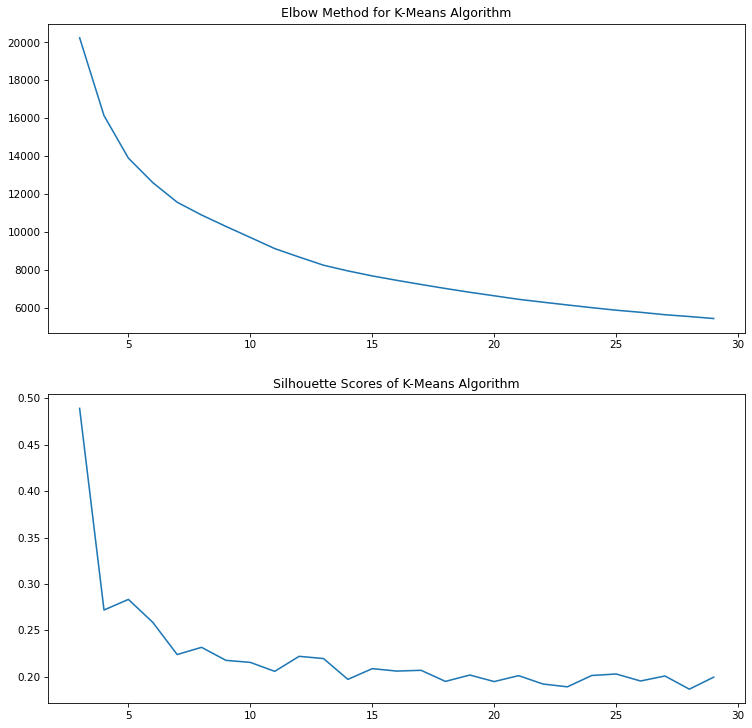

In [32]:
# clustering algorithms
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

ks = list(range(3, 30))

ds = [] # sum of distances to its center
ss = [] # silhouettes scores
for k in tqdm(ks):
    kmeans = KMeans(n_clusters=k).fit(aspect_test)
    ds.append(kmeans.inertia_)
    ss.append(silhouette_score(aspect_test, kmeans.labels_, metric="euclidean", 
                               sample_size=1000)) # for speed
    
fig, axes = plt.subplots(2, 1, figsize=(12, 12), dpi=75)
axes = axes.flatten()

sns.lineplot(x=ks, y=ds, ax=axes[0]).set_title("Elbow Method for K-Means Algorithm")
sns.lineplot(x=ks, y=ss, ax=axes[1]).set_title("Silhouette Scores of K-Means Algorithm")
print("", end="") # remove matplotlib message

In [71]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

# best silhouette score at k=4
n_star = 4
kmeans = KMeans(n_clusters=n_star).fit(aspect_test)
#df_tsne = TSNE(n_components=2).fit_transform(nmf_tfid_dtm_trim)
df_pca = PCA(n_components=2).fit_transform(aspect_test)

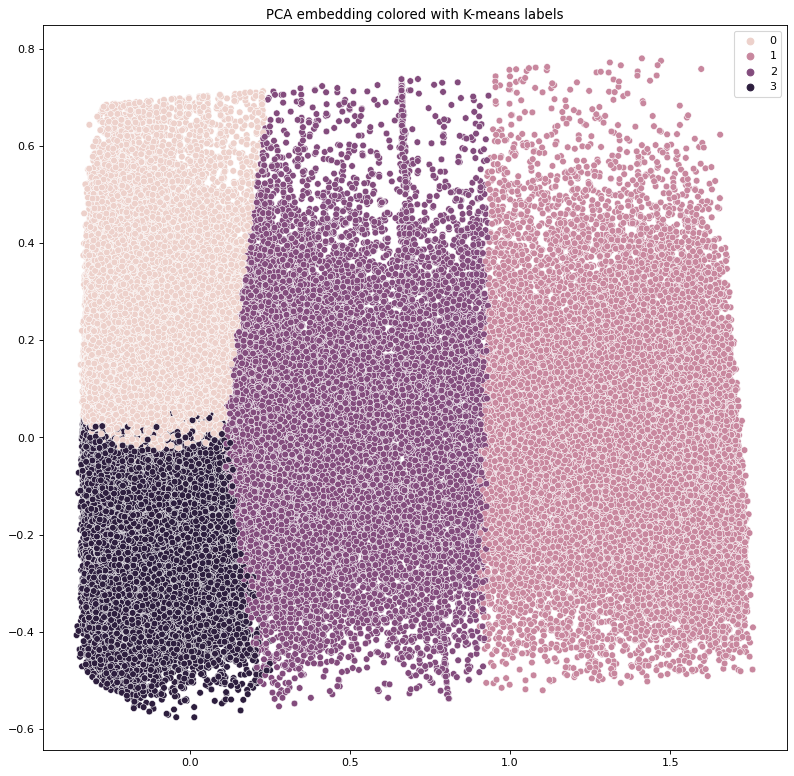

In [72]:
fig, axes = plt.subplots(1,1, figsize=(12, 12), dpi=80)
#axes = axes.flatten()

(sns
 .scatterplot(x=df_pca[:, 0], y=df_pca[:, 1], hue=kmeans.labels_)
 .set_title("PCA embedding colored with K-means labels"))

print("", end="") # remove matplotlib message

In [34]:
# look at the descriptive statistics for each cluster
for c_i in range(n_star):
    display(f"Cluster {c_i}")
    display(aspect_test[kmeans.labels_ == c_i].describe())

'Cluster 0'

,price_score,ambience_score,service_score,food_score,sentiment_score
count,15272.000000,15272.000000,15272.000000,15272.000000,15272.000000
mean,0.082389,0.317969,0.273184,0.326457,0.954523
std,0.046974,0.047752,0.046916,0.043160,0.047865
min,0.000000,0.218245,0.152572,0.195654,0.733900
25%,0.043620,0.280066,0.237720,0.295267,0.938100
50%,0.082416,0.315318,0.272918,0.328345,0.972100
75%,0.118398,0.353009,0.307042,0.359158,0.988500
max,0.201510,0.455449,0.408496,0.432091,0.999900


'Cluster 1'

,price_score,ambience_score,service_score,food_score,sentiment_score
count,5181.000000,5181.000000,5181.000000,5181.000000,5181.000000
mean,0.118823,0.136215,0.363924,0.381039,-0.846924
std,0.083989,0.076469,0.088924,0.088298,0.097558
min,0.000000,0.000000,0.028720,0.053591,-0.997900
25%,0.060572,0.076574,0.303086,0.319197,-0.928800
50%,0.102597,0.131794,0.372205,0.379498,-0.863100
75%,0.155965,0.188313,0.431794,0.442677,-0.778300
max,0.649994,0.391713,0.563190,0.656773,-0.572700


'Cluster 2'

,price_score,ambience_score,service_score,food_score,sentiment_score
count,16366.000000,16366.000000,16366.000000,16366.000000,16366.000000
mean,0.084097,0.125270,0.228730,0.561903,0.944872
std,0.048122,0.048933,0.052530,0.050625,0.051482
min,0.000000,0.000000,0.092404,0.453616,0.739100
25%,0.045572,0.092169,0.189402,0.522934,0.919900
50%,0.082528,0.130631,0.227127,0.557837,0.962300
75%,0.119868,0.162373,0.265383,0.599036,0.984600
max,0.228835,0.233182,0.421746,0.716941,0.999800


'Cluster 3'

,price_score,ambience_score,service_score,food_score,sentiment_score
count,2196.000000,2196.000000,2196.000000,2196.000000,2196.000000
mean,0.162538,0.355095,0.201896,0.280472,0.082146
std,0.147755,0.145981,0.109463,0.120865,0.141097
min,0.000000,0.000000,0.000000,0.000000,-0.296000
25%,0.052653,0.262355,0.117125,0.193170,0.000000
50%,0.126597,0.341784,0.208920,0.287919,0.087600
75%,0.229609,0.441954,0.289720,0.374773,0.199100
max,0.975814,1.000000,0.477875,0.568728,0.381800


## LDA Topic Modeling

In [187]:
# for tf DTM
lda_tf = LatentDirichletAllocation(n_components=15, learning_method='online', random_state=0)
lda_tf.fit(tf_dtm)

# for tfid DTM
lda_tfidf = LatentDirichletAllocation(n_components=15, learning_method='online', random_state=1)
lda_tfidf.fit(tfid_dtm)

LatentDirichletAllocation(learning_method='online', n_components=15,
                          random_state=1)

In [188]:
print_top_words(lda_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: dish atmosphere overall buffet tea hotel regular seafood quickly receive pho mix casino joint truly
Topic 1: rice decide spicy cake bbq employee noodle seating crispy hostess vegan crowd waffle tuna vegetarian
Topic 2: restaurant visit beef bacon rib reservation slice toast sausage worker strawberry banana pittsburgh hash spinach
Topic 3: absolutely decor salmon fact phoenix simple request ton avocado typical diner casual expectation scottsdale multiple
Topic 4: order strip extra sunday saturday friday grab completely rare filet cashier section host company poke
Topic 5: cheese potato arrive group veggie pancake ambiance pack immediately salty 00 melt save bathroom mall
Topic 6: salad review sushi item highly thai yelp style cocktail treat sample asian value tofu latte
Topic 7: vegas tasty portion dessert appetizer add crab bartender las brunch lobster ingredient spice view entire
Topic 8: fry serve sandwich breakfast shrimp onion mushroom milk vegetable establishment compare 

In [189]:
print_top_words(lda_tfidf, tfid_vectorizer.get_feature_names(), n_top)

Topic 0: sandwich breakfast bacon entree order pasta slice toast delivery tomato sausage vegetarian 00 sample banana
Topic 1: wing regular brunch onion quickly mushroom worker charlotte crepe 50 bake duck machine biscuit scallop
Topic 2: server cake tea decor vegan milk non boba 30 bakery casual occasion iced suggestion delish
Topic 3: staff fry atmosphere item group dine completely bathroom event asian dressing booth lettuce shopping brew
Topic 4: visit vegas waitress portion tasty dessert decide waiter rice manager appetizer bartender bbq crab include
Topic 5: salad selection absolutely buffet cocktail salmon value avocado 10 indian texture folk tofu craft mini
Topic 6: cheese strip add chef yelp bean grill burrito donut ton dollar melt continue rate app
Topic 7: owner business rib friday greet consider immediately waffle establishment save creamy presentation typical slightly addition
Topic 8: dish customer quality average mention curry pack juicy smoothie easily grocery traditional

# Looking at aspect/sentiment terms

In [207]:
#description??
def preprocess_sentiment(review_column):

    sentiment_terms = []

    for review in tqdm(nlp.pipe(review_column)):
        if review.is_parsed:
            sentiment_terms.append(' '.join([token.lemma_ for token in review if (not token.is_stop and not token.is_punct and (token.pos_=='ADJ' or token.pos_=='VERB'))]))
        else:
            sentiment_terms.append('')
    return sentiment_terms
    

In [208]:
sentiment_text = preprocess_sentiment(df_subset.review_text)


0it [00:00, ?it/s]
1it [00:10, 10.46s/it]
1001it [00:21,  7.32s/it]
2001it [00:31,  5.13s/it]
3001it [00:42,  3.59s/it]
4001it [00:53,  2.52s/it]
5001it [01:04,  1.77s/it]
6001it [01:14,  1.24s/it]
7001it [01:24,  1.15it/s]
8001it [01:35,  1.63it/s]
9001it [01:45,  2.31it/s]
10001it [01:56,  3.27it/s]
11001it [02:07,  4.60it/s]
12001it [02:18,  6.43it/s]
13001it [02:29,  8.92it/s]
14001it [02:40, 12.26it/s]
15001it [02:50, 16.61it/s]
16001it [03:01, 22.05it/s]
17001it [03:12, 28.53it/s]
18001it [03:22, 36.03it/s]
19001it [03:33, 44.30it/s]
20001it [03:44, 52.41it/s]
21001it [03:54, 60.41it/s]
22001it [04:05, 67.58it/s]
23001it [04:15, 74.43it/s]
24001it [04:26, 79.22it/s]
25001it [04:36, 83.96it/s]
26001it [04:47, 87.81it/s]
27001it [04:57, 90.76it/s]
28001it [05:07, 91.97it/s]
29001it [05:18, 92.50it/s]
30001it [05:28, 93.21it/s]
31001it [05:39, 94.53it/s]
32001it [05:49, 95.14it/s]
33001it [05:59, 96.04it/s]
34001it [06:10, 96.10it/s]
35542it [06:15, 94.59it/s] 


# Generating Bag of word

In [20]:
tf_vectorizer = CountVectorizer(max_df=0.5, min_df=10, stop_words='english', max_features=1000)
tf_dtm = tf_vectorizer.fit_transform(df_sentence)

In [286]:
tf_test_vectorizer = CountVectorizer(max_df=0.5, min_df=10, stop_words='english', max_features=1000)
tf_dtm_test = tf_test_vectorizer.fit_transform(text_test)

# LSA and NMF Topic modeling

## NMF

In [24]:
nmf_tf = NMF(n_components=20, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm)

print_top_words(nmf_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: food amazing quality price mexican fresh excellent fast serve decent chinese ok enjoy authentic portion
Topic 1: good pretty pizza thing taste vegas beer selection price experience sushi town burger flavor far
Topic 2: place recommend favorite definitely look vegas star new friend want review clean know visit amazing
Topic 3: order pizza minute appetizer burger roll cheese tell salad egg steak pick husband friend medium
Topic 4: great atmosphere experience price beer selection spot location flavor pizza overall meal night coffee taste
Topic 5: time long visit second experience vegas lunch location year couple day dinner week enjoy check
Topic 6: like taste feel look thing sauce flavor little people lot know way think meat pizza
Topic 7: come definitely friend ask dinner check lunch manager year night vegas tell meal day server
Topic 8: service customer excellent bad slow amazing fast star friendly quick horrible terrible poor attentive awesome
Topic 9: try want definitely deci

In [221]:
nmf_tf = NMF(n_components=10, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm_aspect)

print_top_words(nmf_tf, tf_aspect_vectorizer.get_feature_names(), n_top)


Topic 0: food atmosphere staff price quality prices stars buffet portions waitress family restaurants places rice thing
Topic 1: place places friends town prices thing reviews atmosphere lunch beer price area lot stars people
Topic 2: sauce chicken fries flavor salad cheese meal meat dish burger rice sandwich bread lunch husband
Topic 3: service location experience server atmosphere stars dinner drinks waiter lunch manager quality meal prices breakfast
Topic 4: pizza crust pizzas cheese wings slice toppings order sauce slices pepperoni salad sausage location delivery
Topic 5: bar staff people room drinks area location hotel experience night lot beer drink line tables
Topic 6: restaurant experience meal dishes restaurants dinner dish soup waiter area dessert wife night family husband
Topic 7: time minutes line day experience wait thing hour things coffee location people review money friend
Topic 8: order table minutes server manager waitress experience tables waiter drinks meal party or

In [283]:
nmf_tf = NMF(n_components=10, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm_sentiment)

print_top_words(nmf_tf, tf_sentiment_vectorizer.get_feature_names(), n_top)


Topic 0: come want try friendly delicious say order eat great wait happy enjoy know love nice
Topic 1: great amazing enjoy happy want nice try say order love know wait friendly eat delicious
Topic 2: want say nice happy know love great order try wait friendly enjoy eat delicious come
Topic 3: order enjoy happy ask want friendly awesome come delicious eat great wait know love nice
Topic 4: love enjoy happy awesome friendly delicious want ask come eat great wait know nice order
Topic 5: try nice enjoy awesome delicious want ask great happy wait friendly know eat love come
Topic 6: delicious amazing happy ask awesome friendly come eat enjoy want wait know love nice order
Topic 7: wait know say delicious try order eat love want ask awesome come great enjoy friendly
Topic 8: know ask friendly say delicious want great love happy wait nice enjoy eat order come
Topic 9: eat awesome friendly say enjoy come amazing ask delicious want wait happy know love nice


In [287]:
nmf_tf = NMF(n_components=20, random_state=42)
tf_dtm_nmf = nmf_tf.fit_transform(tf_dtm_test)

print_top_words(nmf_tf, tf_test_vectorizer.get_feature_names(), n_top)


Topic 0: order delivery waitress arrive decide waiter appetizer receive deliver item extra bartender quickly portion glass
Topic 1: restaurant waiter review visit quality serve dining decide decor atmosphere dine dessert hostess owner reservation
Topic 2: pizza slice pepperoni wing topping sausage delivery style oven dough review chicago pasta mushroom ingredient
Topic 3: fry wing potato onion crispy bacon serve juicy tasty bbq bun pickle truffle waffle chili
Topic 4: dish serve pasta plate chef appetizer dessert portion noodle shrimp tofu mushroom entree overall duck
Topic 5: vegas hotel las strip visit casino review view locate yelp bathroom reservation dining beef parking
Topic 6: salad dressing potato lettuce tomato pasta caesar tasty shrimp entree dessert salmon avocado item serve
Topic 7: sushi tuna quality salmon chef spicy ayce sashimi item nigiri tempura selection rice appetizer miso
Topic 8: taco tacos asada tortilla carne bean beef burrito pastor guacamole shrimp tasty atmos

## LSA

In [25]:
lsa_tf = TruncatedSVD(10)
lsa_tf.fit_transform(tf_dtm)

print_top_words(lsa_tf, tf_vectorizer.get_feature_names(), n_top)

Topic 0: good food place great service order come time like try restaurant price eat love drink
Topic 1: food great place service order come time like love wait delicious amazing drink try friendly
Topic 2: food service great good delicious excellent price quality fast amazing fresh atmosphere friendly mexican portion
Topic 3: order come time like wait chicken drink ask minute try table menu fry cheese salad
Topic 4: food place love like delicious mexican recommend try chinese quality amazing eat authentic favorite star
Topic 5: order place great food good chicken fry cheese pizza appetizer burger salad beef shrimp pork
Topic 6: like taste feel look chicken restaurant sauce great flavor fry cheese little menu thing meat
Topic 7: time service like try long eat wait order food restaurant visit customer second bad feel
Topic 8: service customer friendly come excellent place bad staff slow like fast nice amazing star order
Topic 9: try restaurant love menu chicken want nice delicious sauce

In [288]:
lsa_tf = TruncatedSVD(10)
lsa_tf.fit_transform(tf_dtm_aspect)

print_top_words(lsa_tf, tf_aspect_vectorizer.get_feature_names(), n_top)

Topic 0: food place service restaurant time menu table people order staff experience sauce server meal bar
Topic 1: food service restaurant order table server minutes experience waitress waiter manager buffet location orders check
Topic 2: service restaurant time table menu order pizza sauce experience meal server bar people minutes salad
Topic 3: service place location drinks coffee manager atmosphere minutes customers sushi card attitude employees management lack
Topic 4: pizza order crust sauce wings time cheese food pizzas minutes slice toppings location delivery salad
Topic 5: time people order table room minutes drinks bar staff line manager experience hotel location coffee
Topic 6: restaurant pizza staff experience room place hotel people table manager area restaurants pizzas family party
Topic 7: time order restaurant sauce chicken rice place flavor dish service meat soup noodles beef minutes
Topic 8: order table minutes server manager waitress place burger restaurant fries win

In [235]:
lsa_tf = TruncatedSVD(5)
lsa_tf.fit_transform(tf_dtm_sentiment)

print_top_words(lsa_tf, tf_sentiment_vectorizer.get_feature_names(), n_top)

Topic 0: great come want try order say know delicious nice love wait friendly eat ask enjoy
Topic 1: great amazing enjoy awesome happy ask nice eat delicious love friendly order try know wait
Topic 2: nice love try enjoy order delicious ask awesome amazing happy know want say friendly great
Topic 3: want say nice come love awesome ask friendly try happy eat great know delicious enjoy
Topic 4: say want know order great wait nice ask happy friendly eat try enjoy awesome amazing


In [291]:
lsa_tf = TruncatedSVD(20)
lsa_tf.fit_transform(tf_dtm_test)

print_top_words(lsa_tf, tf_test_vectorizer.get_feature_names(), n_top)

Topic 0: order restaurant pizza dish cheese meal server salad fry serve staff visit sandwich location customer
Topic 1: order pizza delivery wing pepperoni topping slice deliver driver oven knot cashier dough employee ordering
Topic 2: pizza restaurant cheese salad slice vegas staff pepperoni topping wing location buffet style dish review
Topic 3: cheese sandwich salad fry potato breakfast buffet meal serve bacon cake plate selection tasty taco
Topic 4: sandwich restaurant cheese location breakfast customer salad staff manager fry wing visit bacon employee hotel
Topic 5: staff vegas server location customer buffet sushi breakfast visit hotel manager cake review las strip
Topic 6: salad server meal dressing dessert pasta manager appetizer entree reservation caesar dish salmon lettuce arrive
Topic 7: sushi sandwich salad vegas restaurant quality rice tuna buffet spicy fry item selection salmon ayce
Topic 8: taco salad sushi rice server tacos asada shrimp bean tortilla carne meal spicy bu

# LDA Topic Modeling

In [28]:
# for tf DTM
lda_tf = LatentDirichletAllocation(n_components=50, learning_method='online', random_state=0)
lda_tf.fit(tf_dtm)

# for tfid DTM
# lda_tfidf = LatentDirichletAllocation(n_components=50, learning_method='online', random_state=1)
# lda_tfidf.fit(tfid_dtm)

LatentDirichletAllocation(learning_method='online', n_components=50,
                          random_state=0)

In [29]:
pyLDAvis.sklearn.prepare(lda_tf, tf_dtm, tf_vectorizer)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
19     0.014651 -0.016700       1        1  3.435672
43     0.014669 -0.016574       2        1  3.268443
22     0.014675 -0.016526       3        1  3.179517
49     0.014704 -0.016287       4        1  2.856222
40     0.014693 -0.016351       5        1  2.749630
3      0.014689 -0.016372       6        1  2.674687
21     0.014709 -0.016224       7        1  2.606455
8     -0.364489  0.008116       8        1  2.559764
38     0.014744 -0.015960       9        1  2.541219
25     0.014707 -0.016208      10        1  2.404483
44     0.014709 -0.016193      11        1  2.372811
14     0.014792 -0.015486      12        1  2.124557
37     0.014767 -0.015700      13        1  2.088423
46     0.014747 -0.015871      14        1  2.068539
1      0.014793 -0.015461      15        1  2.065780
13     0.014763 -0.015725      16        1  2.047568
27     0.014778 -0.015600      17        1  2.044192
4      0.014781 -0.015568      18        1  2.034757
41     0.014761 -0.015742      19        1  1.978894
35     0.014778 -0.015586      20        1  1.978404
39     0.014784 -0.015531      21        1  1.967629
32     0.014795 -0.015438      22        1  1.965551
7      0.014803 -0.015350      23        1  1.965019
34     0.014800 -0.015376      24        1  1.942244
31     0.014800 -0.015369      25        1  1.933386
33     0.014792 -0.015449      26        1  1.901897
12     0.023696  0.347664      27        1  1.855820
16     0.014789 -0.015482      28        1  1.827223
6      0.014803 -0.015337      29        1  1.808893
23     0.014809 -0.015275      30        1  1.782199
24     0.014815 -0.015212      31        1  1.768396
10     0.014816 -0.015195      32        1  1.760982
18     0.014829 -0.015054      33        1  1.702393
36     0.014815 -0.015213      34        1  1.693947
11     0.023697  0.347274      35        1  1.689108
47    -0.363131  0.008241      36        1  1.688238
20     0.014805 -0.015339      37        1  1.671085
42     0.014843 -0.014884      38        1  1.662416
28     0.014823 -0.015137      39        1  1.658149
48     0.014825 -0.015107      40        1  1.653566
0      0.014821 -0.015154      41        1  1.644096
26     0.014833 -0.015029      42        1  1.621802
2      0.014845 -0.014870      43        1  1.583368
45     0.014854 -0.014751      44        1  1.541815
17     0.014845 -0.014887      45        1  1.541714
30     0.014856 -0.014765      46        1  1.493843
15     0.014863 -0.014657      47        1  1.482518
5      0.014875 -0.014485      48        1  1.443776
9      0.014882 -0.014395      49        1  1.397896
29     0.014895 -0.014420      50        1  1.271012, topic_info=          Term          Freq         Total Category  logprob  loglift
374       good  24310.000000  24310.000000  Default   30.000  30.0000
345       food  22387.000000  22387.000000  Default   29.000  29.0000
652      place  19061.000000  19061.000000  Default   28.000  28.0000
379      great  15834.000000  15834.000000  Default   27.000  27.0000
604      order  15140.000000  15140.000000  Default   26.000  26.0000
..         ...           ...           ...      ...      ...      ...
327       fast      0.023023   1389.679211  Topic50  -13.363  -6.6427
341     flight      0.023023    252.489256  Topic50  -13.363  -4.9373
317       face      0.023023    463.005414  Topic50  -13.363  -5.5437
326        far      0.023023   1609.258205  Topic50  -13.363  -6.7894
325  fantastic      0.023023   1481.970405  Topic50  -13.363  -6.7070

[2027 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
0        18  0.998518         able
1        37  0.996244     absolute
2        39  0.999551   absolutely
3        48  0.997690  accommodate
4         7  0.995833       actual
...     ...       ...          ...
995      28  0.996543    yesterday
996     

In [238]:
pyLDAvis.sklearn.prepare(lda_tfidf, tfid_dtm, tfid_vectorizer)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
36     0.169610 -0.063435       1        1  8.833774
11     0.170145 -0.130488       2        1  7.886296
33     0.160825 -0.145066       3        1  5.863475
32     0.169353 -0.037272       4        1  5.446445
13     0.190846 -0.039917       5        1  5.379416
6      0.186605 -0.104962       6        1  5.118158
24     0.177044 -0.044242       7        1  4.346323
40     0.188687 -0.065943       8        1  3.867199
25     0.232137  0.029879       9        1  3.319658
30     0.192991  0.062105      10        1  3.266426
31     0.169911 -0.035435      11        1  3.245737
34     0.221931  0.162484      12        1  3.077636
5      0.201347  0.021678      13        1  2.998242
18     0.225545  0.169110      14        1  2.530411
15     0.201646  0.023500      15        1  2.507572
17     0.184264  0.119185      16        1  2.175599
43     0.187495 -0.025505      17        1  2.118498
37     0.041690 -0.120843      18        1  2.056006
20     0.150400 -0.039553      19        1  1.998442
42     0.145933  0.097495      20        1  1.765173
4      0.051722  0.128406      21        1  1.702315
19     0.130851  0.179454      22        1  1.430604
48     0.066705  0.134424      23        1  1.149835
0     -0.067296  0.063102      24        1  1.020537
39    -0.145501  0.042681      25        1  0.976481
44    -0.165500  0.107068      26        1  0.952234
12    -0.118583  0.078243      27        1  0.853451
1     -0.137530 -0.113898      28        1  0.844789
14    -0.087459 -0.027450      29        1  0.817616
29    -0.131613  0.014786      30        1  0.794441
9     -0.127038  0.027050      31        1  0.750539
23    -0.164852  0.053773      32        1  0.727424
47    -0.186095  0.090008      33        1  0.711988
38    -0.131890  0.004310      34        1  0.699803
28    -0.172662  0.056167      35        1  0.688616
41    -0.163834  0.046908      36        1  0.687234
26    -0.175215  0.034522      37        1  0.663723
45    -0.187931  0.027343      38        1  0.646032
10    -0.172677  0.027297      39        1  0.631721
3     -0.198427  0.020764      40        1  0.612760
7     -0.182587  0.005218      41        1  0.595754
21    -0.183969 -0.030073      42        1  0.559180
46    -0.193559 -0.005117      43        1  0.545555
16    -0.185532 -0.035272      44        1  0.525404
22    -0.191871 -0.041310      45        1  0.520251
49    -0.171171 -0.041124      46        1  0.512141
2     -0.161187 -0.121289      47        1  0.444506
27    -0.115645 -0.147504      48        1  0.409499
35     0.050970 -0.205633      49        1  0.362543
8      0.050970 -0.205633      50        1  0.362543, topic_info=             Term        Freq       Total Category  logprob  loglift
651         pizza  914.000000  914.000000  Default  30.0000  30.0000
509         lunch  723.000000  723.000000  Default  29.0000  29.0000
219         cream  374.000000  374.000000  Default  28.0000  28.0000
438           ice  369.000000  369.000000  Default  27.0000  27.0000
762      sandwich  477.000000  477.000000  Default  26.0000  26.0000
..            ...         ...         ...      ...      ...      ...
467          know    0.571207  432.252292  Topic50  -6.9078  -1.0092
286          duck    0.571207  110.531872  Topic50  -6.9078   0.3545
693  professional    0.571207   97.545939  Topic50  -6.9078   0.4795
872         super    0.571207  364.488945  Topic50  -6.9078  -0.8387
383         greek    0.571207  103.938440  Topic50  -6.9078   0.4160

[2196 rows x 6 columns], token_table=      Topic      Freq   Term
term                        
0         1  0.084677   able
0         3  0.138563   able
0         4  0.061583   able
0         5  0.061583   able
0         6  0.130865   able
...     ...       ...    ...
999      16  0.060770  yummy
999      21  0.098167  yummy
999      39  0.205682  yummy
999      49  0.0

In [297]:
# for tf DTM
lda_test = LatentDirichletAllocation(n_components=50, learning_method='online', random_state=0)
lda_test.fit(tf_dtm_test)

LatentDirichletAllocation(learning_method='online', n_components=50,
                          random_state=0)

In [294]:
topic_word_distributions = np.array([row / row.sum() for row in lda_test.components_])
topic_word_distributions.sum(axis=1)


array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1.])

In [296]:
num_top_words = 10

print('Displaying the top %d words per topic and their probabilities within the topic...' % num_top_words)
print()

for topic_idx in range(10):
    print('[Topic ', topic_idx, ']', sep='')
    sort_indices = np.argsort(-topic_word_distributions[topic_idx])
    for rank in range(num_top_words):
        word_idx = sort_indices[rank]
        print(tf_vectorizer.get_feature_names()[word_idx], ':', topic_word_distributions[topic_idx, word_idx])
    print()

Displaying the top 10 words per topic and their probabilities within the topic...

[Topic 0]
basic : 0.13008855620054938
casino : 0.10305947144354316
blow : 0.0830101432451233
wall : 0.06383310496267375
wait : 0.04926727850647337
start : 0.04246586324725062
inside : 0.031745341264910146
note : 0.03113890400955618
interior : 0.024441278227167965
job : 0.023619912659690958

[Topic 1]
different : 0.1795064940865036
oyster : 0.08766164901152686
carrot : 0.07519420249719766
fan : 0.06629019238588936
refill : 0.06296350924603383
question : 0.03774660027924068
quickly : 0.03651792734763692
mean : 0.02778748023429056
bathroom : 0.02672310931036621
charge : 0.02590911640410968

[Topic 2]
guacamole : 0.13320680277042168
classic : 0.0750816026948132
pork : 0.06732016420736904
single : 0.053720667747848526
pop : 0.041320677927744104
open : 0.03632332754300866
salmon : 0.03123886510644996
machine : 0.029422529390119124
pasta : 0.026927607657417977
middle : 0.026619316750901494

[Topic 3]
sad : 0.23

In [168]:
topic_word_distributions = np.array([row / row.sum() for row in lda.components_])
topic_word_distributions.sum(axis=1)


array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [169]:
num_top_words = 20

print('Displaying the top %d words per topic and their probabilities within the topic...' % num_top_words)
print()

for topic_idx in range(10):
    print('[Topic ', topic_idx, ']', sep='')
    sort_indices = np.argsort(-topic_word_distributions[topic_idx])
    for rank in range(num_top_words):
        word_idx = sort_indices[rank]
        print(tf_vectorizer.get_feature_names()[word_idx], ':', topic_word_distributions[topic_idx, word_idx])
    print()

Displaying the top 20 words per topic and their probabilities within the topic...

[Topic 0]
chicago : 0.2643122670218589
wish : 0.05063058755883529
run : 0.048995623451659726
care : 0.03006181694878978
area : 0.03002888582080552
board : 0.01588546630000396
woman : 0.012876536017851388
paper : 0.012047958548187838
single : 0.011965459120239129
tacos : 0.011642945358999995
gluten : 0.010676267034343136
friendly : 0.0100809495085904
guest : 0.009923193921227346
fact : 0.009434972893348449
yelp : 0.008304975336779081
mexican : 0.007877388867621586
situation : 0.006994838944039855
decide : 0.006420584411982943
credit : 0.006275546525839755
know : 0.005960938988698062

[Topic 1]
gluten : 0.040477624414284166
dinner : 0.02587975656621456
poke : 0.02061129565828426
base : 0.01844295607613923
flavorful : 0.016544188253995885
vegetable : 0.01634052478959941
share : 0.0157936270764977
non : 0.013441954283194288
got : 0.012665336574033322
chicago : 0.01205313764838532
sort : 0.01123678599987113
p

In [147]:
def prob_see_word1_given_see_word2(word1, word2, vectorizer, eps=0.1):
    word1_column_idx = vectorizer.vocabulary_[word1]
    word2_column_idx = vectorizer.vocabulary_[word2]
    documents_with_word1 = (tf[:, word1_column_idx].toarray().flatten() > 0)
    documents_with_word2 = (tf[:, word2_column_idx].toarray().flatten() > 0)
    documents_with_both_word1_and_word2 = documents_with_word1 * documents_with_word2
    return np.log2((documents_with_both_word1_and_word2.sum() + eps) / documents_with_word2.sum())

In [149]:
average_coherence = 0
for topic_idx in range(10):
    print('[Topic ', topic_idx, ']', sep='')
    sort_indices = np.argsort(topic_word_distributions[topic_idx])[::-1]
    coherence = 0.
    for top_word_idx1 in sort_indices[:num_top_words]:
        word1 = tf_vectorizer.get_feature_names()[top_word_idx1]
        for top_word_idx2 in sort_indices[:num_top_words]:
            word2 = tf_vectorizer.get_feature_names()[top_word_idx2]
            if top_word_idx1 != top_word_idx2:
                coherence += prob_see_word1_given_see_word2(word1, word2, tf_vectorizer, 0.1)
    print('Coherence:', coherence)
    print()
    average_coherence += coherence
average_coherence /= 10
print('Average coherence:', average_coherence)

[Topic 0]
Coherence: -1144.1262227264792

[Topic 1]
Coherence: -1056.588581538603

[Topic 2]
Coherence: -776.5332004694563

[Topic 3]
Coherence: -890.4164613052455

[Topic 4]
Coherence: -1234.7537662398947

[Topic 5]
Coherence: -1059.1392943640162

[Topic 6]
Coherence: -922.7222150514596

[Topic 7]
Coherence: -869.8543893338486

[Topic 8]
Coherence: -918.9523019519904

[Topic 9]
Coherence: -850.7923497842121

Average coherence: -972.3878782765205


zipf plot shows using tfidf is more ideal

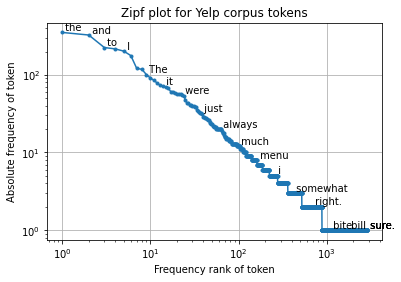

In [44]:
yelp_review_tokens = df_data_preprocessed.review_text.sum()
yelp_review_vocab = nltk.FreqDist(yelp_review_tokens.split())
yelp_review_vocab_counts = np.array(list(yelp_review_vocab.values()))
yelp_review_vocab_tokens = list(yelp_review_vocab.keys())

# zipf plot
ranks = np.arange(1, len(yelp_review_vocab_counts)+1)
indices = np.argsort(-yelp_review_vocab_counts)
frequencies = yelp_review_vocab_counts[indices]
plt.loglog(ranks, frequencies, marker=".")
plt.title("Zipf plot for Yelp corpus tokens")
plt.xlabel("Frequency rank of token")
plt.ylabel("Absolute frequency of token")
plt.grid(True)
for n in list(np.logspace(-0.5, np.log10(len(yelp_review_vocab_counts)), 20).astype(int)):
    dummy = plt.text(ranks[n-1], frequencies[n-1], " " + yelp_review_vocab_tokens[indices[n-1]], 
                 verticalalignment="bottom",
                 horizontalalignment="left")
